# Project: People Flow Detection & Heatmap Visualization
Objective: Using Object Tracking & Heatmap Visualization, Build a system that counts how many people enter or exit a defined area based on movement across two lines.

Submitted by: Selim Ahmed

## Setup and Library Installation

In [ ]:
!pip install -q ultralytics opencv-python tqdm

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 26.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 113.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 91.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 56.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 188.7/188.7 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 107.1 MB/s eta 0:00:00


## Import Required Libraries

In [ ]:
import os
import numpy as np

# computer vision tasks such as image and video processing
import cv2

# display progress bars for loops and iterations
from tqdm import tqdm

# object detection
from ultralytics import YOLO

# IPython to display outputs
from IPython.display import HTML, display, Image
from base64 import b64encode

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


## Other necessary methods

### Play video

In [ ]:
def play_video(video_path, title="Video"):
    mp4 = open(video_path,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
    display(HTML(f"""
        <h4>{title}</h4>
        <video width=750 controls>
            <source src="{data_url}" type="video/mp4">
        </video>
    """))

### File Delete

In [ ]:
def delete_file(file_path):
  if os.path.exists(file_path):
      os.remove(file_path)
      print(f"Deleted: {file_path}")
  else:
      print("File not found!")

## Delete Existing Output

In [ ]:
delete_file('people-walking.mp4')
delete_file("output-annotated-walking.mp4")
delete_file("output-heatmap-video.mp4")
delete_file("output-heatmap-image.jpg")

File not found!
File not found!
File not found!
File not found!


## Download Sample Videos

In [ ]:
!wget -O people-walking.mp4 https://media.roboflow.com/supervision/video-examples/people-walking.mp4
video_path = 'people-walking.mp4'

--2025-08-09 09:25:46--  https://media.roboflow.com/supervision/video-examples/people-walking.mp4
Resolving media.roboflow.com (media.roboflow.com)... 34.110.133.209
Connecting to media.roboflow.com (media.roboflow.com)|34.110.133.209|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 7606633 (7.3M) [video/mp4]
Saving to: ‘people-walking.mp4’

people-walking.mp4  100%[===================>]   7.25M  --.-KB/s    in 0.1s    

2025-08-09 09:25:47 (72.4 MB/s) - ‘people-walking.mp4’ saved [7606633/7606633]



In [ ]:
play_video("people-walking.mp4", "📹 Original Video: People Walking")

## Initialize capture

In [ ]:
# Open the video file
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    print("Error: Could not open video.")
else:
    width  = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    video_fps   = cap.get(cv2.CAP_PROP_FPS)
    frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

    print(f"Video Resolution: {width} x {height}")
    print(f"FPS: {video_fps}")
    print(f"Total Frames: {frame_count}")

Video Resolution: 1920 x 1080
FPS: 25.0
Total Frames: 341


## Define IN/OUT lines

In [ ]:
# How to set line coordination using numpy array
# np.array([[start_x, start_y], [end_x, end_y]])

# Draw lines
top_line = np.array([[1, 350], [1920, 350]])
bottom_line = np.array([[1, 666], [1920, 666]])

# Recalculate average y positions
top_y = int(np.mean(top_line[:, 1]))
bottom_y = int(np.mean(bottom_line[:, 1]))

## Load Model

In [ ]:
model = YOLO('yolov8x.pt')
print("✅ YOLOv8 model loaded")

✅ YOLOv8 model loaded


## Output Video Setup

In [ ]:
output_path = 'output-annotated-walking.avi'
fourcc = cv2.VideoWriter_fourcc(*'XVID')

out = cv2.VideoWriter(output_path, fourcc, video_fps, (width, height))

## Define Deliverable Variables

In [ ]:
id_positions = {}
id_states = {}

in_count = 0
out_count = 0

## Heatmap canvas

In [ ]:
heatmap_canvas = np.zeros((height, width), dtype=np.float32)
fade_alpha = 0.95

## Frame loop

In [ ]:
for i in tqdm(range(frame_count), desc="Processing video"):
    ret, frame = cap.read()
    if not ret:
        break

    # Perform tracking
    results = model.track(frame, classes=[0], persist=True, verbose=False)
    boxes = results[0].boxes.xyxy.tolist()
    track_ids = results[0].boxes.id.int().tolist() if results[0].boxes.id is not None else []

    current_ids = set()
    cv2.line(frame, tuple(top_line[0]), tuple(top_line[1]), (0, 128, 0), 2)
    cv2.line(frame, tuple(bottom_line[0]), tuple(bottom_line[1]), (0, 0, 255), 2)

    # First print line: detections
    print(f"[Frame {i}] Detections: {len(boxes)}, IDs: {track_ids}")

    for box, track_id in zip(boxes, track_ids):
        x1, y1, x2, y2 = map(int, box)
        cx, cy = (x1 + x2) // 2, (y1 + y2) // 2
        current_ids.add(track_id)

        if track_id in id_positions:
            prev_y = id_positions[track_id]
            if prev_y < top_y and cy >= top_y and id_states.get(track_id) != "in":
                in_count += 1
                id_states[track_id] = "in"
            elif prev_y > bottom_y and cy <= bottom_y and id_states.get(track_id) != "out":
                out_count += 1
                id_states[track_id] = "out"

        id_positions[track_id] = cy

        color = (255, 255, 255)
        if id_states.get(track_id) == "in":
            color = (0, 128, 0)
        elif id_states.get(track_id) == "out":
            color = (0, 0, 255)

        cv2.rectangle(frame, (x1, y1), (x2, y2), color, 2)
        cv2.putText(frame, f"ID: {track_id}", (x1, y1 - 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
        cv2.circle(frame, (cx, cy), 5, color, -1)

        # Heatmap accumulation
        cv2.circle(heatmap_canvas, (cx, cy), 8, 1, -1)

    # Remove lost IDs
    lost_ids = set(id_positions.keys()) - current_ids
    for lost_id in lost_ids:
        id_positions.pop(lost_id, None)
        id_states.pop(lost_id, None)

    # Heatmap overlay
    heatmap_canvas *= fade_alpha
    temp_heatmap = np.clip(heatmap_canvas, 0, 255)
    temp_heatmap = cv2.GaussianBlur(temp_heatmap, (31, 31), 0)
    heatmap_color = cv2.applyColorMap(temp_heatmap.astype(np.uint8), cv2.COLORMAP_JET)
    overlay = cv2.addWeighted(frame, 0.7, heatmap_color, 0.5, 0)

    # Second print line: counts
    print(f"[Frame {i}] IN Count: {in_count}, OUT Count: {out_count}, Total Count: {len(current_ids)}\n")

    # Overlay counters on video
    cv2.putText(overlay, f"IN Count: {in_count}", (20, 40), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 128, 0), 2)
    cv2.putText(overlay, f"OUT Count: {out_count}", (20, 90), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)
    cv2.putText(overlay, f"Total Count: {len(current_ids)}", (20, 140), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 0), 2)

    out.write(overlay)

cap.release()
out.release()


# Save final heatmap image
print(f"✅ Annotated video saved: {output_path}")

Processing video:   0%|          | 0/341 [00:00<?, ?it/s]

requirements: Ultralytics requirement ['lap>=0.5.12'] not found, attempting AutoUpdate...

requirements: AutoUpdate success ✅ 0.9s
WARNING ⚠️ requirements: Restart runtime or rerun command for updates to take effect



Processing video:   0%|          | 1/341 [00:09<54:04,  9.54s/it]

[Frame 0] Detections: 35, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35]
[Frame 0] IN Count: 0, OUT Count: 0, Total Count: 35



Processing video:   1%|          | 3/341 [00:09<12:42,  2.26s/it]

[Frame 1] Detections: 35, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35]
[Frame 1] IN Count: 0, OUT Count: 0, Total Count: 35

[Frame 2] Detections: 35, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35]
[Frame 2] IN Count: 0, OUT Count: 0, Total Count: 35



Processing video:   1%|▏         | 5/341 [00:10<05:20,  1.05it/s]

[Frame 3] Detections: 34, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32, 33, 34, 35]
[Frame 3] IN Count: 0, OUT Count: 0, Total Count: 34

[Frame 4] Detections: 34, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32, 33, 34, 35]
[Frame 4] IN Count: 0, OUT Count: 0, Total Count: 34



Processing video:   2%|▏         | 7/341 [00:10<02:45,  2.02it/s]

[Frame 5] Detections: 34, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32, 33, 34, 35]
[Frame 5] IN Count: 1, OUT Count: 0, Total Count: 34

[Frame 6] Detections: 34, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32, 33, 34, 35]
[Frame 6] IN Count: 1, OUT Count: 0, Total Count: 34



Processing video:   3%|▎         | 9/341 [00:10<01:38,  3.36it/s]

[Frame 7] Detections: 34, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32, 33, 34, 35]
[Frame 7] IN Count: 1, OUT Count: 0, Total Count: 34

[Frame 8] Detections: 34, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32, 33, 34, 35]
[Frame 8] IN Count: 1, OUT Count: 0, Total Count: 34



Processing video:   3%|▎         | 11/341 [00:10<01:07,  4.89it/s]

[Frame 9] Detections: 34, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32, 33, 34, 35]
[Frame 9] IN Count: 1, OUT Count: 0, Total Count: 34

[Frame 10] Detections: 34, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32, 33, 34, 35]
[Frame 10] IN Count: 1, OUT Count: 0, Total Count: 34



Processing video:   4%|▍         | 13/341 [00:11<00:52,  6.20it/s]

[Frame 11] Detections: 34, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32, 33, 34, 35]
[Frame 11] IN Count: 1, OUT Count: 0, Total Count: 34

[Frame 12] Detections: 33, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35]
[Frame 12] IN Count: 1, OUT Count: 0, Total Count: 33



Processing video:   4%|▍         | 15/341 [00:11<00:46,  6.98it/s]

[Frame 13] Detections: 34, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48]
[Frame 13] IN Count: 1, OUT Count: 0, Total Count: 34

[Frame 14] Detections: 34, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48]
[Frame 14] IN Count: 1, OUT Count: 0, Total Count: 34



Processing video:   5%|▍         | 17/341 [00:11<00:42,  7.62it/s]

[Frame 15] Detections: 34, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48]
[Frame 15] IN Count: 1, OUT Count: 0, Total Count: 34

[Frame 16] Detections: 34, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48]
[Frame 16] IN Count: 1, OUT Count: 1, Total Count: 34



Processing video:   6%|▌         | 19/341 [00:11<00:40,  7.92it/s]

[Frame 17] Detections: 34, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48]
[Frame 17] IN Count: 1, OUT Count: 1, Total Count: 34

[Frame 18] Detections: 35, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48, 29]
[Frame 18] IN Count: 1, OUT Count: 1, Total Count: 35



Processing video:   6%|▌         | 21/341 [00:12<00:39,  8.13it/s]

[Frame 19] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48, 54, 29]
[Frame 19] IN Count: 1, OUT Count: 1, Total Count: 36

[Frame 20] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48, 54, 29]
[Frame 20] IN Count: 1, OUT Count: 1, Total Count: 36



Processing video:   7%|▋         | 23/341 [00:12<00:39,  8.10it/s]

[Frame 21] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48, 54, 29]
[Frame 21] IN Count: 1, OUT Count: 1, Total Count: 36

[Frame 22] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48, 54, 29]
[Frame 22] IN Count: 1, OUT Count: 1, Total Count: 36



Processing video:   7%|▋         | 25/341 [00:12<00:38,  8.18it/s]

[Frame 23] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48, 54, 29]
[Frame 23] IN Count: 1, OUT Count: 1, Total Count: 36

[Frame 24] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48, 54, 29]
[Frame 24] IN Count: 1, OUT Count: 1, Total Count: 36



Processing video:   8%|▊         | 27/341 [00:12<00:37,  8.32it/s]

[Frame 25] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48, 54, 29]
[Frame 25] IN Count: 1, OUT Count: 1, Total Count: 36

[Frame 26] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48, 54, 29]
[Frame 26] IN Count: 1, OUT Count: 1, Total Count: 36



Processing video:   9%|▊         | 29/341 [00:13<00:37,  8.32it/s]

[Frame 27] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48, 54, 29]
[Frame 27] IN Count: 1, OUT Count: 1, Total Count: 36

[Frame 28] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48, 54, 29]
[Frame 28] IN Count: 1, OUT Count: 1, Total Count: 36



Processing video:   9%|▉         | 31/341 [00:13<00:36,  8.39it/s]

[Frame 29] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48, 54, 29]
[Frame 29] IN Count: 1, OUT Count: 1, Total Count: 36

[Frame 30] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48, 54, 29]
[Frame 30] IN Count: 1, OUT Count: 1, Total Count: 36



Processing video:  10%|▉         | 33/341 [00:13<00:37,  8.16it/s]

[Frame 31] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48, 54, 29]
[Frame 31] IN Count: 1, OUT Count: 2, Total Count: 36

[Frame 32] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48, 54, 29, 71]
[Frame 32] IN Count: 1, OUT Count: 2, Total Count: 37



Processing video:  10%|█         | 35/341 [00:13<00:36,  8.29it/s]

[Frame 33] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48, 54, 29, 71]
[Frame 33] IN Count: 1, OUT Count: 2, Total Count: 37

[Frame 34] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48, 54, 29, 71]
[Frame 34] IN Count: 1, OUT Count: 2, Total Count: 37



Processing video:  11%|█         | 37/341 [00:14<00:36,  8.36it/s]

[Frame 35] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48, 54, 29, 71]
[Frame 35] IN Count: 1, OUT Count: 2, Total Count: 37

[Frame 36] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48, 54, 29, 71]
[Frame 36] IN Count: 1, OUT Count: 2, Total Count: 37



Processing video:  11%|█▏        | 39/341 [00:14<00:37,  8.09it/s]

[Frame 37] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32, 33, 34, 35, 48, 54, 29, 71]
[Frame 37] IN Count: 1, OUT Count: 2, Total Count: 37

[Frame 38] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 31, 32, 33, 34, 35, 48, 54, 29, 71, 73]
[Frame 38] IN Count: 1, OUT Count: 2, Total Count: 37



Processing video:  12%|█▏        | 41/341 [00:14<00:37,  8.07it/s]

[Frame 39] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 31, 32, 33, 34, 35, 54, 29, 71, 73]
[Frame 39] IN Count: 1, OUT Count: 2, Total Count: 36

[Frame 40] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 31, 32, 33, 34, 35, 54, 29, 71, 73, 74]
[Frame 40] IN Count: 1, OUT Count: 2, Total Count: 37



Processing video:  13%|█▎        | 43/341 [00:14<00:36,  8.20it/s]

[Frame 41] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 31, 32, 33, 34, 35, 29, 71, 73, 74, 75]
[Frame 41] IN Count: 1, OUT Count: 2, Total Count: 37

[Frame 42] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 31, 32, 33, 34, 35, 29, 71, 73, 74, 75]
[Frame 42] IN Count: 1, OUT Count: 2, Total Count: 37



Processing video:  13%|█▎        | 45/341 [00:15<00:35,  8.26it/s]

[Frame 43] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 31, 32, 33, 34, 35, 29, 71, 73, 74, 75]
[Frame 43] IN Count: 1, OUT Count: 2, Total Count: 37

[Frame 44] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 29, 71, 73, 74, 75]
[Frame 44] IN Count: 1, OUT Count: 2, Total Count: 36



Processing video:  14%|█▍        | 47/341 [00:15<00:35,  8.24it/s]

[Frame 45] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 29, 71, 73, 74, 75]
[Frame 45] IN Count: 1, OUT Count: 2, Total Count: 36

[Frame 46] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 29, 71, 73, 74, 75]
[Frame 46] IN Count: 1, OUT Count: 2, Total Count: 36



Processing video:  14%|█▍        | 49/341 [00:15<00:36,  7.91it/s]

[Frame 47] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 32, 33, 34, 35, 29, 71, 73, 74, 75]
[Frame 47] IN Count: 1, OUT Count: 2, Total Count: 36

[Frame 48] Detections: 35, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 73, 74, 75]
[Frame 48] IN Count: 1, OUT Count: 2, Total Count: 35



Processing video:  15%|█▍        | 51/341 [00:15<00:35,  8.06it/s]

[Frame 49] Detections: 35, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 73, 74, 75]
[Frame 49] IN Count: 1, OUT Count: 2, Total Count: 35

[Frame 50] Detections: 35, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 73, 74, 75]
[Frame 50] IN Count: 1, OUT Count: 2, Total Count: 35



Processing video:  16%|█▌        | 53/341 [00:15<00:35,  8.12it/s]

[Frame 51] Detections: 35, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 73, 74, 75]
[Frame 51] IN Count: 1, OUT Count: 2, Total Count: 35

[Frame 52] Detections: 35, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 73, 74, 75]
[Frame 52] IN Count: 1, OUT Count: 2, Total Count: 35



Processing video:  16%|█▌        | 55/341 [00:16<00:35,  8.17it/s]

[Frame 53] Detections: 35, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 73, 74, 75]
[Frame 53] IN Count: 1, OUT Count: 2, Total Count: 35

[Frame 54] Detections: 35, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 73, 74, 75]
[Frame 54] IN Count: 1, OUT Count: 2, Total Count: 35



Processing video:  17%|█▋        | 57/341 [00:16<00:34,  8.22it/s]

[Frame 55] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 73, 74, 75, 54]
[Frame 55] IN Count: 1, OUT Count: 2, Total Count: 36

[Frame 56] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 73, 74, 75, 54]
[Frame 56] IN Count: 2, OUT Count: 2, Total Count: 36



Processing video:  17%|█▋        | 59/341 [00:16<00:34,  8.23it/s]

[Frame 57] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 73, 74, 75, 54]
[Frame 57] IN Count: 2, OUT Count: 2, Total Count: 36

[Frame 58] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 73, 74, 75, 54, 89]
[Frame 58] IN Count: 2, OUT Count: 2, Total Count: 37



Processing video:  18%|█▊        | 61/341 [00:16<00:34,  8.12it/s]

[Frame 59] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 73, 74, 75, 54, 89]
[Frame 59] IN Count: 2, OUT Count: 2, Total Count: 37

[Frame 60] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 73, 74, 75, 54, 89]
[Frame 60] IN Count: 2, OUT Count: 2, Total Count: 36



Processing video:  18%|█▊        | 63/341 [00:17<00:34,  8.04it/s]

[Frame 61] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 73, 74, 75, 54, 89]
[Frame 61] IN Count: 3, OUT Count: 2, Total Count: 36

[Frame 62] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 73, 74, 75, 54, 89, 21]
[Frame 62] IN Count: 3, OUT Count: 2, Total Count: 37



Processing video:  19%|█▉        | 65/341 [00:17<00:35,  7.84it/s]

[Frame 63] Detections: 35, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 73, 74, 75, 89, 21]
[Frame 63] IN Count: 3, OUT Count: 2, Total Count: 35

[Frame 64] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 73, 74, 75, 89, 21, 19]
[Frame 64] IN Count: 4, OUT Count: 2, Total Count: 36



Processing video:  19%|█▉        | 66/341 [00:17<00:39,  6.99it/s]

[Frame 65] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 73, 74, 75, 89, 21, 91, 19]
[Frame 65] IN Count: 4, OUT Count: 2, Total Count: 37

[Frame 66] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19]
[Frame 66] IN Count: 4, OUT Count: 2, Total Count: 36



Processing video:  20%|█▉        | 68/341 [00:17<00:42,  6.45it/s]

[Frame 67] Detections: 35, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19]
[Frame 67] IN Count: 4, OUT Count: 2, Total Count: 35

[Frame 68] Detections: 35, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19]


Processing video:  21%|██        | 70/341 [00:18<00:43,  6.29it/s]

[Frame 68] IN Count: 4, OUT Count: 2, Total Count: 35

[Frame 69] Detections: 35, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19]
[Frame 69] IN Count: 4, OUT Count: 2, Total Count: 35



Processing video:  21%|██        | 71/341 [00:18<00:44,  6.11it/s]

[Frame 70] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19, 97]
[Frame 70] IN Count: 4, OUT Count: 2, Total Count: 36

[Frame 71] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19, 97]


Processing video:  21%|██▏       | 73/341 [00:18<00:45,  5.94it/s]

[Frame 71] IN Count: 5, OUT Count: 2, Total Count: 36

[Frame 72] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19, 97]
[Frame 72] IN Count: 5, OUT Count: 2, Total Count: 36



Processing video:  22%|██▏       | 74/341 [00:19<00:45,  5.89it/s]

[Frame 73] Detections: 38, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19, 97, 98, 99]
[Frame 73] IN Count: 5, OUT Count: 3, Total Count: 38

[Frame 74] Detections: 38, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19, 97, 98, 99]


Processing video:  22%|██▏       | 76/341 [00:19<00:45,  5.87it/s]

[Frame 74] IN Count: 5, OUT Count: 3, Total Count: 38

[Frame 75] Detections: 38, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19, 97, 98, 99]
[Frame 75] IN Count: 5, OUT Count: 3, Total Count: 38



Processing video:  23%|██▎       | 77/341 [00:19<00:44,  5.93it/s]

[Frame 76] Detections: 38, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19, 97, 98, 99]
[Frame 76] IN Count: 5, OUT Count: 3, Total Count: 38

[Frame 77] Detections: 38, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19, 97, 98, 99]


Processing video:  23%|██▎       | 79/341 [00:19<00:41,  6.25it/s]

[Frame 77] IN Count: 5, OUT Count: 3, Total Count: 38

[Frame 78] Detections: 38, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19, 97, 98, 99]
[Frame 78] IN Count: 5, OUT Count: 3, Total Count: 38



Processing video:  24%|██▍       | 81/341 [00:20<00:37,  7.01it/s]

[Frame 79] Detections: 38, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19, 97, 98, 99]
[Frame 79] IN Count: 5, OUT Count: 3, Total Count: 38

[Frame 80] Detections: 38, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19, 97, 98, 99]
[Frame 80] IN Count: 5, OUT Count: 3, Total Count: 38



Processing video:  24%|██▍       | 83/341 [00:20<00:33,  7.61it/s]

[Frame 81] Detections: 38, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19, 97, 98, 99]
[Frame 81] IN Count: 5, OUT Count: 3, Total Count: 38

[Frame 82] Detections: 38, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19, 97, 98, 99]
[Frame 82] IN Count: 5, OUT Count: 3, Total Count: 38



Processing video:  25%|██▍       | 85/341 [00:20<00:32,  7.89it/s]

[Frame 83] Detections: 38, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19, 97, 98, 99]
[Frame 83] IN Count: 5, OUT Count: 3, Total Count: 38

[Frame 84] Detections: 38, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19, 97, 98, 99]
[Frame 84] IN Count: 5, OUT Count: 3, Total Count: 38



Processing video:  26%|██▌       | 87/341 [00:20<00:31,  8.16it/s]

[Frame 85] Detections: 38, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19, 97, 98, 99]
[Frame 85] IN Count: 5, OUT Count: 3, Total Count: 38

[Frame 86] Detections: 38, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19, 97, 98, 99]
[Frame 86] IN Count: 5, OUT Count: 3, Total Count: 38



Processing video:  26%|██▌       | 89/341 [00:21<00:30,  8.27it/s]

[Frame 87] Detections: 38, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19, 97, 98, 99]
[Frame 87] IN Count: 5, OUT Count: 3, Total Count: 38

[Frame 88] Detections: 38, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19, 97, 98, 99]
[Frame 88] IN Count: 5, OUT Count: 3, Total Count: 38



Processing video:  26%|██▋       | 90/341 [00:21<00:30,  8.17it/s]

[Frame 89] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 19, 97, 98, 99]
[Frame 89] IN Count: 5, OUT Count: 3, Total Count: 37

[Frame 90] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 97, 98, 99, 109]
[Frame 90] IN Count: 5, OUT Count: 3, Total Count: 37



Processing video:  27%|██▋       | 92/341 [00:21<00:37,  6.71it/s]

[Frame 91] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 97, 98, 99, 109]
[Frame 91] IN Count: 5, OUT Count: 3, Total Count: 37

[Frame 92] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 97, 98, 99, 109]


Processing video:  27%|██▋       | 93/341 [00:21<00:38,  6.47it/s]

[Frame 92] IN Count: 5, OUT Count: 3, Total Count: 37

[Frame 93] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 97, 98, 99, 109]
[Frame 93] IN Count: 5, OUT Count: 3, Total Count: 37



Processing video:  28%|██▊       | 96/341 [00:22<00:35,  6.99it/s]

[Frame 94] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 17, 18, 20, 22, 23, 24, 25, 26, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 97, 98, 99, 109]
[Frame 94] IN Count: 5, OUT Count: 3, Total Count: 37

[Frame 95] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 97, 98, 99, 109]
[Frame 95] IN Count: 5, OUT Count: 3, Total Count: 36



Processing video:  29%|██▊       | 98/341 [00:22<00:32,  7.48it/s]

[Frame 96] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 97, 98, 99, 109]
[Frame 96] IN Count: 5, OUT Count: 3, Total Count: 36

[Frame 97] Detections: 35, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 97, 98, 99, 109]
[Frame 97] IN Count: 5, OUT Count: 3, Total Count: 35



Processing video:  29%|██▉       | 100/341 [00:22<00:30,  7.86it/s]

[Frame 98] Detections: 35, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 97, 98, 99, 109]
[Frame 98] IN Count: 6, OUT Count: 3, Total Count: 35

[Frame 99] Detections: 35, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 97, 98, 99, 109]
[Frame 99] IN Count: 6, OUT Count: 3, Total Count: 35



Processing video:  30%|██▉       | 102/341 [00:22<00:30,  7.75it/s]

[Frame 100] Detections: 35, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 97, 98, 99, 109]
[Frame 100] IN Count: 6, OUT Count: 3, Total Count: 35

[Frame 101] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 97, 98, 99, 109, 26]
[Frame 101] IN Count: 6, OUT Count: 3, Total Count: 36



Processing video:  30%|███       | 104/341 [00:23<00:30,  7.90it/s]

[Frame 102] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 97, 98, 99, 109, 26]
[Frame 102] IN Count: 6, OUT Count: 3, Total Count: 36

[Frame 103] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 97, 98, 99, 109, 26]
[Frame 103] IN Count: 7, OUT Count: 3, Total Count: 36



Processing video:  31%|███       | 106/341 [00:23<00:29,  8.08it/s]

[Frame 104] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 97, 98, 99, 109, 26]
[Frame 104] IN Count: 7, OUT Count: 3, Total Count: 36

[Frame 105] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 97, 98, 99, 109, 26]
[Frame 105] IN Count: 7, OUT Count: 3, Total Count: 36



Processing video:  32%|███▏      | 108/341 [00:23<00:28,  8.12it/s]

[Frame 106] Detections: 38, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 21, 91, 97, 98, 99, 109, 26, 120, 121]
[Frame 106] IN Count: 7, OUT Count: 3, Total Count: 38

[Frame 107] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 26, 120, 121]
[Frame 107] IN Count: 7, OUT Count: 3, Total Count: 37



Processing video:  32%|███▏      | 110/341 [00:23<00:28,  8.21it/s]

[Frame 108] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 26, 120, 121]
[Frame 108] IN Count: 7, OUT Count: 3, Total Count: 37

[Frame 109] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 26, 120, 121]
[Frame 109] IN Count: 7, OUT Count: 3, Total Count: 37



Processing video:  33%|███▎      | 112/341 [00:24<00:28,  8.12it/s]

[Frame 110] Detections: 37, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 26, 120, 121]
[Frame 110] IN Count: 7, OUT Count: 3, Total Count: 37

[Frame 111] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 26, 120]
[Frame 111] IN Count: 7, OUT Count: 3, Total Count: 36



Processing video:  33%|███▎      | 114/341 [00:24<00:27,  8.15it/s]

[Frame 112] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 26, 120]
[Frame 112] IN Count: 7, OUT Count: 3, Total Count: 36

[Frame 113] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 26, 120]
[Frame 113] IN Count: 7, OUT Count: 3, Total Count: 36



Processing video:  34%|███▍      | 116/341 [00:24<00:27,  8.18it/s]

[Frame 114] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 26, 120]
[Frame 114] IN Count: 7, OUT Count: 3, Total Count: 36

[Frame 115] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 26, 120]
[Frame 115] IN Count: 7, OUT Count: 3, Total Count: 36



Processing video:  35%|███▍      | 118/341 [00:24<00:26,  8.26it/s]

[Frame 116] Detections: 36, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 26, 120]
[Frame 116] IN Count: 7, OUT Count: 3, Total Count: 36

[Frame 117] Detections: 35, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120]
[Frame 117] IN Count: 7, OUT Count: 3, Total Count: 35



Processing video:  35%|███▌      | 120/341 [00:25<00:27,  8.05it/s]

[Frame 118] Detections: 34, IDs: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120]
[Frame 118] IN Count: 7, OUT Count: 3, Total Count: 34

[Frame 119] Detections: 33, IDs: [1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120]
[Frame 119] IN Count: 7, OUT Count: 3, Total Count: 33



Processing video:  36%|███▌      | 122/341 [00:25<00:26,  8.13it/s]

[Frame 120] Detections: 33, IDs: [1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120]
[Frame 120] IN Count: 7, OUT Count: 3, Total Count: 33

[Frame 121] Detections: 33, IDs: [1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120]
[Frame 121] IN Count: 7, OUT Count: 3, Total Count: 33



Processing video:  36%|███▋      | 124/341 [00:25<00:26,  8.27it/s]

[Frame 122] Detections: 33, IDs: [1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120]
[Frame 122] IN Count: 7, OUT Count: 3, Total Count: 33

[Frame 123] Detections: 34, IDs: [1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 127]
[Frame 123] IN Count: 7, OUT Count: 3, Total Count: 34



Processing video:  37%|███▋      | 126/341 [00:25<00:26,  8.24it/s]

[Frame 124] Detections: 34, IDs: [1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 127]
[Frame 124] IN Count: 7, OUT Count: 3, Total Count: 34

[Frame 125] Detections: 33, IDs: [1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120]
[Frame 125] IN Count: 7, OUT Count: 4, Total Count: 33



Processing video:  38%|███▊      | 128/341 [00:26<00:26,  8.12it/s]

[Frame 126] Detections: 33, IDs: [1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120]
[Frame 126] IN Count: 7, OUT Count: 4, Total Count: 33

[Frame 127] Detections: 33, IDs: [1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120]
[Frame 127] IN Count: 7, OUT Count: 4, Total Count: 33



Processing video:  38%|███▊      | 130/341 [00:26<00:26,  8.11it/s]

[Frame 128] Detections: 33, IDs: [1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120]
[Frame 128] IN Count: 7, OUT Count: 4, Total Count: 33

[Frame 129] Detections: 33, IDs: [1, 2, 3, 4, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 129] IN Count: 7, OUT Count: 4, Total Count: 33



Processing video:  39%|███▊      | 132/341 [00:26<00:25,  8.15it/s]

[Frame 130] Detections: 33, IDs: [1, 2, 3, 4, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 130] IN Count: 7, OUT Count: 4, Total Count: 33

[Frame 131] Detections: 33, IDs: [1, 2, 3, 4, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 27, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 131] IN Count: 7, OUT Count: 4, Total Count: 33



Processing video:  39%|███▉      | 134/341 [00:26<00:25,  8.25it/s]

[Frame 132] Detections: 31, IDs: [2, 3, 4, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 132] IN Count: 7, OUT Count: 4, Total Count: 31

[Frame 133] Detections: 31, IDs: [2, 3, 4, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 133] IN Count: 7, OUT Count: 4, Total Count: 31



Processing video:  40%|███▉      | 136/341 [00:27<00:25,  8.06it/s]

[Frame 134] Detections: 31, IDs: [2, 3, 4, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 134] IN Count: 7, OUT Count: 4, Total Count: 31

[Frame 135] Detections: 31, IDs: [2, 3, 4, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 135] IN Count: 7, OUT Count: 4, Total Count: 31



Processing video:  40%|████      | 138/341 [00:27<00:24,  8.12it/s]

[Frame 136] Detections: 31, IDs: [2, 3, 4, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 136] IN Count: 7, OUT Count: 4, Total Count: 31

[Frame 137] Detections: 31, IDs: [2, 3, 4, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 137] IN Count: 7, OUT Count: 4, Total Count: 31



Processing video:  41%|████      | 140/341 [00:27<00:24,  8.12it/s]

[Frame 138] Detections: 31, IDs: [2, 3, 4, 7, 8, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 138] IN Count: 7, OUT Count: 4, Total Count: 31

[Frame 139] Detections: 30, IDs: [2, 3, 4, 7, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 139] IN Count: 7, OUT Count: 5, Total Count: 30



Processing video:  42%|████▏     | 142/341 [00:27<00:24,  8.14it/s]

[Frame 140] Detections: 30, IDs: [2, 3, 4, 7, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 140] IN Count: 7, OUT Count: 5, Total Count: 30

[Frame 141] Detections: 30, IDs: [2, 3, 4, 7, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 141] IN Count: 7, OUT Count: 5, Total Count: 30



Processing video:  42%|████▏     | 144/341 [00:28<00:24,  8.12it/s]

[Frame 142] Detections: 30, IDs: [2, 3, 4, 7, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 142] IN Count: 7, OUT Count: 5, Total Count: 30

[Frame 143] Detections: 30, IDs: [2, 3, 4, 7, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 143] IN Count: 8, OUT Count: 5, Total Count: 30



Processing video:  43%|████▎     | 146/341 [00:28<00:23,  8.25it/s]

[Frame 144] Detections: 30, IDs: [2, 3, 4, 7, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 144] IN Count: 8, OUT Count: 5, Total Count: 30

[Frame 145] Detections: 30, IDs: [2, 3, 4, 7, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 145] IN Count: 8, OUT Count: 5, Total Count: 30



Processing video:  43%|████▎     | 148/341 [00:28<00:23,  8.26it/s]

[Frame 146] Detections: 30, IDs: [2, 3, 4, 7, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 146] IN Count: 8, OUT Count: 5, Total Count: 30

[Frame 147] Detections: 30, IDs: [2, 3, 4, 7, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 147] IN Count: 9, OUT Count: 5, Total Count: 30



Processing video:  44%|████▍     | 150/341 [00:28<00:22,  8.41it/s]

[Frame 148] Detections: 30, IDs: [2, 3, 4, 7, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 148] IN Count: 9, OUT Count: 5, Total Count: 30

[Frame 149] Detections: 30, IDs: [2, 3, 4, 7, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 149] IN Count: 9, OUT Count: 5, Total Count: 30



Processing video:  45%|████▍     | 152/341 [00:28<00:22,  8.33it/s]

[Frame 150] Detections: 30, IDs: [2, 3, 4, 7, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 150] IN Count: 9, OUT Count: 5, Total Count: 30

[Frame 151] Detections: 30, IDs: [2, 3, 4, 7, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 109, 120, 132]
[Frame 151] IN Count: 9, OUT Count: 5, Total Count: 30



Processing video:  45%|████▌     | 154/341 [00:29<00:22,  8.17it/s]

[Frame 152] Detections: 29, IDs: [2, 3, 4, 7, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132]
[Frame 152] IN Count: 9, OUT Count: 5, Total Count: 29

[Frame 153] Detections: 29, IDs: [2, 3, 4, 7, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132]
[Frame 153] IN Count: 9, OUT Count: 5, Total Count: 29



Processing video:  46%|████▌     | 156/341 [00:29<00:22,  8.35it/s]

[Frame 154] Detections: 29, IDs: [2, 3, 4, 7, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132]
[Frame 154] IN Count: 9, OUT Count: 5, Total Count: 29

[Frame 155] Detections: 29, IDs: [2, 3, 4, 7, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132]
[Frame 155] IN Count: 9, OUT Count: 5, Total Count: 29



Processing video:  46%|████▋     | 158/341 [00:29<00:22,  8.01it/s]

[Frame 156] Detections: 29, IDs: [2, 3, 4, 7, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132]
[Frame 156] IN Count: 9, OUT Count: 5, Total Count: 29

[Frame 157] Detections: 29, IDs: [2, 3, 4, 7, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132]
[Frame 157] IN Count: 9, OUT Count: 5, Total Count: 29



Processing video:  47%|████▋     | 159/341 [00:29<00:24,  7.41it/s]

[Frame 158] Detections: 29, IDs: [2, 3, 4, 7, 9, 10, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132]
[Frame 158] IN Count: 9, OUT Count: 5, Total Count: 29

[Frame 159] Detections: 28, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132]


Processing video:  47%|████▋     | 160/341 [00:30<00:26,  6.90it/s]

[Frame 159] IN Count: 9, OUT Count: 6, Total Count: 28

[Frame 160] Detections: 29, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137]
[Frame 160] IN Count: 9, OUT Count: 6, Total Count: 29



Processing video:  48%|████▊     | 162/341 [00:30<00:28,  6.34it/s]

[Frame 161] Detections: 29, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137]
[Frame 161] IN Count: 9, OUT Count: 6, Total Count: 29

[Frame 162] Detections: 29, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137]


Processing video:  48%|████▊     | 164/341 [00:30<00:28,  6.22it/s]

[Frame 162] IN Count: 9, OUT Count: 6, Total Count: 29

[Frame 163] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137, 10]
[Frame 163] IN Count: 9, OUT Count: 6, Total Count: 30



Processing video:  48%|████▊     | 165/341 [00:30<00:28,  6.11it/s]

[Frame 164] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137, 10]
[Frame 164] IN Count: 9, OUT Count: 6, Total Count: 30

[Frame 165] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137, 10]
[Frame 165] IN Count: 9, OUT Count: 6, Total Count: 30



Processing video:  49%|████▉     | 167/341 [00:31<00:28,  6.02it/s]

[Frame 166] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137, 10]
[Frame 166] IN Count: 9, OUT Count: 6, Total Count: 30

[Frame 167] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137, 10]


Processing video:  50%|████▉     | 169/341 [00:31<00:29,  5.80it/s]

[Frame 167] IN Count: 9, OUT Count: 6, Total Count: 30

[Frame 168] Detections: 29, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137]
[Frame 168] IN Count: 9, OUT Count: 6, Total Count: 29



Processing video:  50%|████▉     | 170/341 [00:31<00:29,  5.83it/s]

[Frame 169] Detections: 29, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137]
[Frame 169] IN Count: 9, OUT Count: 6, Total Count: 29

[Frame 170] Detections: 29, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137]
[Frame 170] IN Count: 9, OUT Count: 6, Total Count: 29



Processing video:  51%|█████     | 173/341 [00:32<00:24,  6.88it/s]

[Frame 171] Detections: 29, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137]
[Frame 171] IN Count: 9, OUT Count: 6, Total Count: 29

[Frame 172] Detections: 29, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137]
[Frame 172] IN Count: 9, OUT Count: 6, Total Count: 29



Processing video:  51%|█████▏    | 175/341 [00:32<00:22,  7.31it/s]

[Frame 173] Detections: 29, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137]
[Frame 173] IN Count: 9, OUT Count: 6, Total Count: 29

[Frame 174] Detections: 29, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137]
[Frame 174] IN Count: 9, OUT Count: 6, Total Count: 29



Processing video:  52%|█████▏    | 177/341 [00:32<00:21,  7.63it/s]

[Frame 175] Detections: 29, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137]
[Frame 175] IN Count: 9, OUT Count: 6, Total Count: 29

[Frame 176] Detections: 29, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137]
[Frame 176] IN Count: 9, OUT Count: 6, Total Count: 29



Processing video:  52%|█████▏    | 179/341 [00:32<00:20,  7.92it/s]

[Frame 177] Detections: 29, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137]
[Frame 177] IN Count: 9, OUT Count: 6, Total Count: 29

[Frame 178] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137, 149]
[Frame 178] IN Count: 9, OUT Count: 6, Total Count: 30



Processing video:  53%|█████▎    | 181/341 [00:33<00:19,  8.16it/s]

[Frame 179] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137, 149]
[Frame 179] IN Count: 9, OUT Count: 6, Total Count: 30

[Frame 180] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137, 149]
[Frame 180] IN Count: 9, OUT Count: 6, Total Count: 30



Processing video:  54%|█████▎    | 183/341 [00:33<00:19,  8.25it/s]

[Frame 181] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137, 149]
[Frame 181] IN Count: 9, OUT Count: 6, Total Count: 30

[Frame 182] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137, 149]
[Frame 182] IN Count: 9, OUT Count: 6, Total Count: 30



Processing video:  54%|█████▍    | 185/341 [00:33<00:18,  8.30it/s]

[Frame 183] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137, 149]
[Frame 183] IN Count: 9, OUT Count: 6, Total Count: 30

[Frame 184] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137, 149]
[Frame 184] IN Count: 9, OUT Count: 6, Total Count: 30



Processing video:  55%|█████▍    | 187/341 [00:33<00:18,  8.33it/s]

[Frame 185] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137, 149]
[Frame 185] IN Count: 9, OUT Count: 6, Total Count: 30

[Frame 186] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137, 149]
[Frame 186] IN Count: 9, OUT Count: 6, Total Count: 30



Processing video:  55%|█████▌    | 189/341 [00:34<00:18,  8.28it/s]

[Frame 187] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137, 149]
[Frame 187] IN Count: 9, OUT Count: 6, Total Count: 30

[Frame 188] Detections: 31, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137, 149, 152]
[Frame 188] IN Count: 9, OUT Count: 6, Total Count: 31



Processing video:  56%|█████▌    | 191/341 [00:34<00:18,  8.09it/s]

[Frame 189] Detections: 31, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 120, 132, 137, 149, 152]
[Frame 189] IN Count: 9, OUT Count: 6, Total Count: 31

[Frame 190] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 132, 137, 149, 152]
[Frame 190] IN Count: 9, OUT Count: 6, Total Count: 30



Processing video:  57%|█████▋    | 193/341 [00:34<00:18,  8.11it/s]

[Frame 191] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 132, 137, 149, 152]
[Frame 191] IN Count: 9, OUT Count: 6, Total Count: 30

[Frame 192] Detections: 31, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 132, 137, 149, 152, 157]
[Frame 192] IN Count: 10, OUT Count: 6, Total Count: 31



Processing video:  57%|█████▋    | 195/341 [00:34<00:17,  8.29it/s]

[Frame 193] Detections: 31, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 132, 137, 149, 152, 157]
[Frame 193] IN Count: 10, OUT Count: 6, Total Count: 31

[Frame 194] Detections: 31, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 132, 137, 149, 152, 157]
[Frame 194] IN Count: 10, OUT Count: 6, Total Count: 31



Processing video:  58%|█████▊    | 197/341 [00:35<00:17,  8.28it/s]

[Frame 195] Detections: 31, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 132, 137, 149, 152, 157]
[Frame 195] IN Count: 10, OUT Count: 6, Total Count: 31

[Frame 196] Detections: 31, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 132, 137, 149, 152, 157]
[Frame 196] IN Count: 10, OUT Count: 6, Total Count: 31



Processing video:  58%|█████▊    | 199/341 [00:35<00:17,  8.25it/s]

[Frame 197] Detections: 32, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 132, 137, 149, 152, 157, 161]
[Frame 197] IN Count: 10, OUT Count: 6, Total Count: 32

[Frame 198] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162]
[Frame 198] IN Count: 10, OUT Count: 6, Total Count: 33



Processing video:  59%|█████▉    | 201/341 [00:35<00:16,  8.24it/s]

[Frame 199] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162]
[Frame 199] IN Count: 10, OUT Count: 6, Total Count: 33

[Frame 200] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162]
[Frame 200] IN Count: 10, OUT Count: 6, Total Count: 33



Processing video:  60%|█████▉    | 203/341 [00:35<00:16,  8.27it/s]

[Frame 201] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162]
[Frame 201] IN Count: 10, OUT Count: 6, Total Count: 33

[Frame 202] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162]
[Frame 202] IN Count: 10, OUT Count: 6, Total Count: 33



Processing video:  60%|██████    | 205/341 [00:36<00:16,  8.18it/s]

[Frame 203] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162]
[Frame 203] IN Count: 10, OUT Count: 6, Total Count: 33

[Frame 204] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162]
[Frame 204] IN Count: 10, OUT Count: 6, Total Count: 33



Processing video:  61%|██████    | 207/341 [00:36<00:16,  8.22it/s]

[Frame 205] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162]
[Frame 205] IN Count: 10, OUT Count: 6, Total Count: 33

[Frame 206] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 91, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162]
[Frame 206] IN Count: 10, OUT Count: 6, Total Count: 33



Processing video:  61%|██████▏   | 209/341 [00:36<00:16,  8.06it/s]

[Frame 207] Detections: 32, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162]
[Frame 207] IN Count: 10, OUT Count: 6, Total Count: 32

[Frame 208] Detections: 32, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162]
[Frame 208] IN Count: 10, OUT Count: 6, Total Count: 32



Processing video:  62%|██████▏   | 211/341 [00:36<00:15,  8.19it/s]

[Frame 209] Detections: 32, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162]
[Frame 209] IN Count: 10, OUT Count: 6, Total Count: 32

[Frame 210] Detections: 32, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162]
[Frame 210] IN Count: 10, OUT Count: 6, Total Count: 32



Processing video:  62%|██████▏   | 213/341 [00:37<00:15,  8.20it/s]

[Frame 211] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162, 165]
[Frame 211] IN Count: 10, OUT Count: 6, Total Count: 33

[Frame 212] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162, 165]
[Frame 212] IN Count: 10, OUT Count: 6, Total Count: 33



Processing video:  63%|██████▎   | 215/341 [00:37<00:15,  8.28it/s]

[Frame 213] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162, 165]
[Frame 213] IN Count: 10, OUT Count: 6, Total Count: 33

[Frame 214] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162, 165]
[Frame 214] IN Count: 10, OUT Count: 6, Total Count: 33



Processing video:  64%|██████▎   | 217/341 [00:37<00:15,  8.18it/s]

[Frame 215] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162, 165]
[Frame 215] IN Count: 10, OUT Count: 6, Total Count: 33

[Frame 216] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162, 165]
[Frame 216] IN Count: 10, OUT Count: 6, Total Count: 33



Processing video:  64%|██████▍   | 219/341 [00:37<00:14,  8.18it/s]

[Frame 217] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162, 165]
[Frame 217] IN Count: 11, OUT Count: 6, Total Count: 33

[Frame 218] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162, 165]
[Frame 218] IN Count: 11, OUT Count: 6, Total Count: 33



Processing video:  65%|██████▍   | 221/341 [00:38<00:14,  8.18it/s]

[Frame 219] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162, 165]
[Frame 219] IN Count: 11, OUT Count: 6, Total Count: 33

[Frame 220] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162, 165]
[Frame 220] IN Count: 11, OUT Count: 6, Total Count: 33



Processing video:  65%|██████▌   | 223/341 [00:38<00:14,  8.21it/s]

[Frame 221] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162, 165]
[Frame 221] IN Count: 11, OUT Count: 6, Total Count: 33

[Frame 222] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162, 165]
[Frame 222] IN Count: 11, OUT Count: 6, Total Count: 33



Processing video:  66%|██████▌   | 225/341 [00:38<00:14,  8.16it/s]

[Frame 223] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162, 165]
[Frame 223] IN Count: 11, OUT Count: 6, Total Count: 33

[Frame 224] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162, 165]
[Frame 224] IN Count: 11, OUT Count: 6, Total Count: 33



Processing video:  67%|██████▋   | 227/341 [00:38<00:13,  8.18it/s]

[Frame 225] Detections: 33, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 162, 165]
[Frame 225] IN Count: 11, OUT Count: 6, Total Count: 33

[Frame 226] Detections: 32, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 165]
[Frame 226] IN Count: 11, OUT Count: 6, Total Count: 32



Processing video:  67%|██████▋   | 229/341 [00:39<00:13,  8.17it/s]

[Frame 227] Detections: 32, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 35, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 165]
[Frame 227] IN Count: 11, OUT Count: 6, Total Count: 32

[Frame 228] Detections: 31, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 165]
[Frame 228] IN Count: 11, OUT Count: 6, Total Count: 31



Processing video:  68%|██████▊   | 231/341 [00:39<00:13,  8.20it/s]

[Frame 229] Detections: 31, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 165]
[Frame 229] IN Count: 11, OUT Count: 6, Total Count: 31

[Frame 230] Detections: 31, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 165]
[Frame 230] IN Count: 11, OUT Count: 6, Total Count: 31



Processing video:  68%|██████▊   | 233/341 [00:39<00:13,  8.25it/s]

[Frame 231] Detections: 31, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 165]
[Frame 231] IN Count: 11, OUT Count: 6, Total Count: 31

[Frame 232] Detections: 32, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 165, 171]
[Frame 232] IN Count: 11, OUT Count: 6, Total Count: 32



Processing video:  69%|██████▉   | 235/341 [00:39<00:12,  8.25it/s]

[Frame 233] Detections: 32, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 165, 171]
[Frame 233] IN Count: 11, OUT Count: 6, Total Count: 32

[Frame 234] Detections: 31, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 171]
[Frame 234] IN Count: 11, OUT Count: 6, Total Count: 31



Processing video:  70%|██████▉   | 237/341 [00:39<00:12,  8.25it/s]

[Frame 235] Detections: 31, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 171]
[Frame 235] IN Count: 11, OUT Count: 6, Total Count: 31

[Frame 236] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161]
[Frame 236] IN Count: 11, OUT Count: 6, Total Count: 30



Processing video:  70%|███████   | 239/341 [00:40<00:12,  8.22it/s]

[Frame 237] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161]
[Frame 237] IN Count: 11, OUT Count: 6, Total Count: 30

[Frame 238] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161]
[Frame 238] IN Count: 11, OUT Count: 6, Total Count: 30



Processing video:  71%|███████   | 241/341 [00:40<00:12,  8.24it/s]

[Frame 239] Detections: 31, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 176]
[Frame 239] IN Count: 11, OUT Count: 6, Total Count: 31

[Frame 240] Detections: 31, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 176]
[Frame 240] IN Count: 11, OUT Count: 6, Total Count: 31



Processing video:  71%|███████▏  | 243/341 [00:40<00:12,  8.06it/s]

[Frame 241] Detections: 31, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 176]
[Frame 241] IN Count: 11, OUT Count: 6, Total Count: 31

[Frame 242] Detections: 31, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 18, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 176]
[Frame 242] IN Count: 11, OUT Count: 6, Total Count: 31



Processing video:  72%|███████▏  | 245/341 [00:40<00:11,  8.11it/s]

[Frame 243] Detections: 31, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 176, 180]
[Frame 243] IN Count: 11, OUT Count: 6, Total Count: 31

[Frame 244] Detections: 30, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 89, 97, 98, 99, 132, 137, 149, 152, 157, 161, 180]
[Frame 244] IN Count: 11, OUT Count: 6, Total Count: 30



Processing video:  72%|███████▏  | 247/341 [00:41<00:11,  8.14it/s]

[Frame 245] Detections: 31, IDs: [2, 3, 4, 7, 9, 11, 14, 17, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 99, 132, 137, 149, 152, 157, 161, 180, 183, 184]
[Frame 245] IN Count: 11, OUT Count: 6, Total Count: 31

[Frame 246] Detections: 31, IDs: [2, 4, 7, 9, 11, 14, 17, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 99, 132, 137, 149, 152, 157, 161, 180, 183, 184, 185]
[Frame 246] IN Count: 11, OUT Count: 6, Total Count: 31



Processing video:  73%|███████▎  | 249/341 [00:41<00:11,  8.32it/s]

[Frame 247] Detections: 30, IDs: [2, 4, 7, 9, 11, 14, 17, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 99, 132, 137, 149, 152, 157, 161, 183, 184, 185]
[Frame 247] IN Count: 11, OUT Count: 6, Total Count: 30

[Frame 248] Detections: 29, IDs: [4, 7, 9, 11, 14, 17, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 99, 132, 137, 149, 152, 157, 161, 183, 184, 185]
[Frame 248] IN Count: 11, OUT Count: 6, Total Count: 29



Processing video:  74%|███████▎  | 251/341 [00:41<00:10,  8.32it/s]

[Frame 249] Detections: 30, IDs: [4, 7, 9, 11, 14, 17, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 99, 132, 137, 149, 152, 157, 161, 183, 184, 185, 186]
[Frame 249] IN Count: 11, OUT Count: 6, Total Count: 30

[Frame 250] Detections: 31, IDs: [4, 7, 9, 11, 14, 17, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 99, 132, 137, 149, 152, 157, 161, 183, 184, 185, 186, 188]
[Frame 250] IN Count: 11, OUT Count: 6, Total Count: 31



Processing video:  74%|███████▍  | 253/341 [00:41<00:11,  7.68it/s]

[Frame 251] Detections: 31, IDs: [4, 7, 9, 11, 14, 17, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 99, 132, 137, 149, 152, 157, 161, 183, 184, 185, 186, 188]
[Frame 251] IN Count: 11, OUT Count: 6, Total Count: 31

[Frame 252] Detections: 31, IDs: [4, 7, 9, 11, 14, 17, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 99, 132, 137, 149, 152, 157, 161, 183, 184, 185, 186, 188]
[Frame 252] IN Count: 11, OUT Count: 6, Total Count: 31



Processing video:  74%|███████▍  | 254/341 [00:42<00:12,  7.15it/s]

[Frame 253] Detections: 32, IDs: [4, 7, 9, 11, 14, 17, 20, 22, 23, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 99, 132, 137, 149, 152, 157, 161, 183, 184, 185, 186, 188, 176]
[Frame 253] IN Count: 11, OUT Count: 6, Total Count: 32

[Frame 254] Detections: 31, IDs: [4, 7, 9, 11, 14, 17, 20, 23, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 99, 132, 137, 149, 152, 157, 161, 183, 184, 185, 186, 188, 176]


Processing video:  75%|███████▌  | 256/341 [00:42<00:13,  6.51it/s]

[Frame 254] IN Count: 11, OUT Count: 6, Total Count: 31

[Frame 255] Detections: 32, IDs: [4, 7, 9, 11, 14, 17, 20, 23, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 99, 132, 137, 149, 152, 157, 161, 183, 184, 185, 186, 188, 176, 192]
[Frame 255] IN Count: 11, OUT Count: 6, Total Count: 32



Processing video:  75%|███████▌  | 257/341 [00:42<00:13,  6.31it/s]

[Frame 256] Detections: 33, IDs: [4, 7, 9, 11, 14, 17, 20, 23, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 99, 132, 137, 149, 152, 157, 161, 183, 184, 185, 186, 188, 176, 192, 194]
[Frame 256] IN Count: 11, OUT Count: 6, Total Count: 33

[Frame 257] Detections: 33, IDs: [4, 7, 9, 11, 14, 17, 20, 23, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 99, 132, 137, 149, 152, 157, 161, 183, 184, 185, 186, 188, 176, 192, 194]


Processing video:  76%|███████▌  | 259/341 [00:42<00:13,  6.02it/s]

[Frame 257] IN Count: 11, OUT Count: 6, Total Count: 33

[Frame 258] Detections: 32, IDs: [4, 7, 9, 11, 14, 17, 20, 23, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 99, 132, 137, 149, 152, 157, 161, 183, 184, 185, 186, 188, 192, 194]
[Frame 258] IN Count: 11, OUT Count: 6, Total Count: 32



Processing video:  76%|███████▌  | 260/341 [00:43<00:13,  5.94it/s]

[Frame 259] Detections: 32, IDs: [4, 7, 9, 11, 14, 17, 20, 23, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 99, 132, 137, 149, 152, 157, 161, 183, 184, 185, 186, 188, 192, 194]
[Frame 259] IN Count: 11, OUT Count: 6, Total Count: 32

[Frame 260] Detections: 30, IDs: [4, 7, 9, 11, 14, 17, 20, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 99, 132, 137, 149, 152, 157, 161, 183, 184, 186, 188, 192, 194]


Processing video:  77%|███████▋  | 262/341 [00:43<00:13,  5.83it/s]

[Frame 260] IN Count: 11, OUT Count: 6, Total Count: 30

[Frame 261] Detections: 30, IDs: [4, 7, 9, 11, 14, 17, 20, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 99, 132, 137, 149, 152, 157, 161, 183, 184, 186, 188, 192, 194]
[Frame 261] IN Count: 11, OUT Count: 6, Total Count: 30



Processing video:  77%|███████▋  | 263/341 [00:43<00:13,  5.84it/s]

[Frame 262] Detections: 30, IDs: [4, 7, 9, 11, 14, 17, 20, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 99, 132, 137, 149, 152, 157, 161, 183, 184, 186, 188, 192, 194]
[Frame 262] IN Count: 11, OUT Count: 6, Total Count: 30

[Frame 263] Detections: 29, IDs: [4, 7, 9, 11, 14, 17, 20, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 132, 137, 149, 152, 157, 161, 183, 184, 186, 188, 192, 194]


Processing video:  78%|███████▊  | 265/341 [00:44<00:13,  5.65it/s]

[Frame 263] IN Count: 11, OUT Count: 6, Total Count: 29

[Frame 264] Detections: 28, IDs: [4, 7, 9, 11, 14, 17, 20, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 132, 137, 149, 152, 157, 161, 183, 184, 186, 188, 192]
[Frame 264] IN Count: 11, OUT Count: 6, Total Count: 28



Processing video:  78%|███████▊  | 267/341 [00:44<00:11,  6.53it/s]

[Frame 265] Detections: 29, IDs: [4, 7, 9, 11, 14, 17, 20, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 132, 137, 149, 152, 157, 161, 183, 184, 186, 188, 192, 198]
[Frame 265] IN Count: 11, OUT Count: 6, Total Count: 29

[Frame 266] Detections: 29, IDs: [4, 7, 9, 11, 14, 17, 20, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 132, 137, 149, 152, 157, 161, 183, 184, 186, 188, 192, 198]
[Frame 266] IN Count: 11, OUT Count: 6, Total Count: 29



Processing video:  79%|███████▉  | 269/341 [00:44<00:10,  7.13it/s]

[Frame 267] Detections: 29, IDs: [4, 7, 9, 11, 14, 17, 20, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 132, 137, 149, 152, 157, 161, 183, 184, 186, 188, 192, 198]
[Frame 267] IN Count: 11, OUT Count: 6, Total Count: 29

[Frame 268] Detections: 29, IDs: [4, 7, 9, 14, 17, 20, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 132, 137, 149, 152, 157, 161, 183, 184, 186, 188, 192, 198, 99]
[Frame 268] IN Count: 11, OUT Count: 6, Total Count: 29



Processing video:  79%|███████▉  | 271/341 [00:44<00:09,  7.43it/s]

[Frame 269] Detections: 29, IDs: [4, 7, 9, 14, 17, 20, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 132, 137, 149, 152, 157, 161, 183, 184, 186, 188, 192, 198, 99]
[Frame 269] IN Count: 11, OUT Count: 6, Total Count: 29

[Frame 270] Detections: 29, IDs: [4, 7, 9, 14, 17, 20, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 132, 137, 149, 152, 157, 161, 183, 184, 186, 188, 192, 198, 99]
[Frame 270] IN Count: 11, OUT Count: 6, Total Count: 29



Processing video:  80%|████████  | 273/341 [00:45<00:08,  7.91it/s]

[Frame 271] Detections: 29, IDs: [4, 7, 9, 14, 17, 20, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 132, 137, 149, 152, 157, 161, 183, 184, 186, 188, 192, 198, 99]
[Frame 271] IN Count: 11, OUT Count: 6, Total Count: 29

[Frame 272] Detections: 29, IDs: [4, 7, 9, 14, 17, 20, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 132, 137, 149, 152, 157, 161, 183, 184, 186, 188, 192, 198, 99]
[Frame 272] IN Count: 11, OUT Count: 6, Total Count: 29



Processing video:  81%|████████  | 275/341 [00:45<00:08,  8.12it/s]

[Frame 273] Detections: 29, IDs: [4, 7, 9, 14, 17, 20, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 132, 137, 149, 152, 157, 161, 183, 184, 186, 188, 192, 198, 99]
[Frame 273] IN Count: 11, OUT Count: 6, Total Count: 29

[Frame 274] Detections: 28, IDs: [4, 7, 9, 14, 17, 20, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 183, 184, 186, 188, 192, 198, 99]
[Frame 274] IN Count: 11, OUT Count: 6, Total Count: 28



Processing video:  81%|████████  | 277/341 [00:45<00:07,  8.20it/s]

[Frame 275] Detections: 29, IDs: [4, 7, 9, 14, 17, 20, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 183, 184, 186, 188, 192, 198, 99, 204]
[Frame 275] IN Count: 11, OUT Count: 6, Total Count: 29

[Frame 276] Detections: 29, IDs: [4, 7, 9, 14, 17, 20, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 183, 184, 186, 188, 192, 198, 99, 204]
[Frame 276] IN Count: 11, OUT Count: 6, Total Count: 29



Processing video:  82%|████████▏ | 279/341 [00:45<00:07,  8.25it/s]

[Frame 277] Detections: 29, IDs: [4, 7, 9, 14, 17, 20, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 183, 184, 186, 188, 192, 198, 99, 204]
[Frame 277] IN Count: 11, OUT Count: 6, Total Count: 29

[Frame 278] Detections: 28, IDs: [4, 7, 9, 14, 17, 20, 24, 25, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 204]
[Frame 278] IN Count: 11, OUT Count: 6, Total Count: 28



Processing video:  82%|████████▏ | 281/341 [00:46<00:07,  8.17it/s]

[Frame 279] Detections: 28, IDs: [4, 7, 9, 14, 17, 20, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 204, 207]
[Frame 279] IN Count: 11, OUT Count: 6, Total Count: 28

[Frame 280] Detections: 27, IDs: [4, 7, 9, 14, 17, 20, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183]
[Frame 280] IN Count: 11, OUT Count: 6, Total Count: 27



Processing video:  83%|████████▎ | 283/341 [00:46<00:07,  8.21it/s]

[Frame 281] Detections: 29, IDs: [4, 7, 9, 14, 17, 20, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 176, 25]
[Frame 281] IN Count: 11, OUT Count: 6, Total Count: 29

[Frame 282] Detections: 31, IDs: [4, 7, 9, 14, 17, 20, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 176, 25]
[Frame 282] IN Count: 11, OUT Count: 7, Total Count: 31



Processing video:  84%|████████▎ | 285/341 [00:46<00:06,  8.28it/s]

[Frame 283] Detections: 30, IDs: [4, 7, 9, 14, 17, 20, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 25]
[Frame 283] IN Count: 11, OUT Count: 7, Total Count: 30

[Frame 284] Detections: 31, IDs: [4, 7, 9, 14, 17, 20, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 25, 218]
[Frame 284] IN Count: 11, OUT Count: 7, Total Count: 31



Processing video:  84%|████████▍ | 287/341 [00:46<00:06,  8.37it/s]

[Frame 285] Detections: 31, IDs: [4, 7, 9, 14, 17, 20, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219]
[Frame 285] IN Count: 11, OUT Count: 7, Total Count: 31

[Frame 286] Detections: 31, IDs: [4, 7, 9, 14, 17, 20, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219]
[Frame 286] IN Count: 11, OUT Count: 7, Total Count: 31



Processing video:  85%|████████▍ | 289/341 [00:46<00:06,  8.18it/s]

[Frame 287] Detections: 31, IDs: [4, 7, 9, 14, 17, 20, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219]
[Frame 287] IN Count: 11, OUT Count: 7, Total Count: 31

[Frame 288] Detections: 31, IDs: [4, 7, 9, 14, 17, 20, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219]
[Frame 288] IN Count: 12, OUT Count: 8, Total Count: 31



Processing video:  85%|████████▌ | 291/341 [00:47<00:06,  8.23it/s]

[Frame 289] Detections: 31, IDs: [4, 7, 9, 14, 17, 20, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219]
[Frame 289] IN Count: 12, OUT Count: 8, Total Count: 31

[Frame 290] Detections: 32, IDs: [4, 7, 9, 14, 17, 20, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223]
[Frame 290] IN Count: 12, OUT Count: 8, Total Count: 32



Processing video:  86%|████████▌ | 293/341 [00:47<00:05,  8.29it/s]

[Frame 291] Detections: 32, IDs: [4, 7, 9, 14, 17, 20, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223]
[Frame 291] IN Count: 12, OUT Count: 8, Total Count: 32

[Frame 292] Detections: 32, IDs: [4, 7, 9, 14, 17, 20, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223]
[Frame 292] IN Count: 12, OUT Count: 8, Total Count: 32



Processing video:  87%|████████▋ | 295/341 [00:47<00:05,  8.27it/s]

[Frame 293] Detections: 32, IDs: [4, 7, 9, 14, 17, 20, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223]
[Frame 293] IN Count: 12, OUT Count: 8, Total Count: 32

[Frame 294] Detections: 32, IDs: [4, 7, 9, 14, 17, 20, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223]
[Frame 294] IN Count: 12, OUT Count: 8, Total Count: 32



Processing video:  87%|████████▋ | 297/341 [00:47<00:05,  8.22it/s]

[Frame 295] Detections: 32, IDs: [4, 7, 9, 14, 17, 20, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223]
[Frame 295] IN Count: 13, OUT Count: 8, Total Count: 32

[Frame 296] Detections: 32, IDs: [4, 7, 9, 14, 17, 20, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223]
[Frame 296] IN Count: 13, OUT Count: 8, Total Count: 32



Processing video:  88%|████████▊ | 299/341 [00:48<00:05,  8.37it/s]

[Frame 297] Detections: 32, IDs: [4, 7, 9, 14, 17, 20, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223]
[Frame 297] IN Count: 13, OUT Count: 8, Total Count: 32

[Frame 298] Detections: 31, IDs: [4, 7, 9, 14, 17, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223]
[Frame 298] IN Count: 13, OUT Count: 8, Total Count: 31



Processing video:  88%|████████▊ | 301/341 [00:48<00:04,  8.43it/s]

[Frame 299] Detections: 31, IDs: [4, 7, 9, 14, 17, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223]
[Frame 299] IN Count: 13, OUT Count: 8, Total Count: 31

[Frame 300] Detections: 31, IDs: [4, 7, 9, 14, 17, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223]
[Frame 300] IN Count: 13, OUT Count: 8, Total Count: 31



Processing video:  89%|████████▉ | 303/341 [00:48<00:04,  8.30it/s]

[Frame 301] Detections: 32, IDs: [4, 7, 9, 14, 17, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 20]
[Frame 301] IN Count: 13, OUT Count: 8, Total Count: 32

[Frame 302] Detections: 32, IDs: [4, 7, 9, 14, 17, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 20]
[Frame 302] IN Count: 13, OUT Count: 8, Total Count: 32



Processing video:  89%|████████▉ | 305/341 [00:48<00:04,  8.27it/s]

[Frame 303] Detections: 33, IDs: [4, 7, 9, 14, 17, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 20, 241]
[Frame 303] IN Count: 13, OUT Count: 8, Total Count: 33

[Frame 304] Detections: 34, IDs: [4, 7, 9, 14, 17, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 20, 241, 245]
[Frame 304] IN Count: 13, OUT Count: 8, Total Count: 34



Processing video:  90%|█████████ | 307/341 [00:49<00:04,  8.05it/s]

[Frame 305] Detections: 33, IDs: [7, 9, 14, 17, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 20, 241, 245]
[Frame 305] IN Count: 13, OUT Count: 8, Total Count: 33

[Frame 306] Detections: 34, IDs: [7, 9, 14, 17, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 20, 241, 245, 250]
[Frame 306] IN Count: 13, OUT Count: 8, Total Count: 34



Processing video:  91%|█████████ | 309/341 [00:49<00:03,  8.03it/s]

[Frame 307] Detections: 34, IDs: [7, 9, 14, 17, 24, 32, 33, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 20, 241, 245, 250]
[Frame 307] IN Count: 13, OUT Count: 8, Total Count: 34

[Frame 308] Detections: 31, IDs: [7, 9, 14, 17, 24, 32, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245]
[Frame 308] IN Count: 13, OUT Count: 8, Total Count: 31



Processing video:  91%|█████████ | 311/341 [00:49<00:03,  8.10it/s]

[Frame 309] Detections: 31, IDs: [7, 9, 14, 17, 24, 32, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245]
[Frame 309] IN Count: 13, OUT Count: 8, Total Count: 31

[Frame 310] Detections: 32, IDs: [7, 9, 14, 17, 24, 32, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 250]
[Frame 310] IN Count: 13, OUT Count: 8, Total Count: 32



Processing video:  92%|█████████▏| 313/341 [00:49<00:03,  8.19it/s]

[Frame 311] Detections: 33, IDs: [7, 9, 14, 17, 24, 32, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250]
[Frame 311] IN Count: 13, OUT Count: 8, Total Count: 33

[Frame 312] Detections: 33, IDs: [7, 9, 14, 17, 24, 32, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250]
[Frame 312] IN Count: 13, OUT Count: 8, Total Count: 33



Processing video:  92%|█████████▏| 315/341 [00:50<00:03,  7.95it/s]

[Frame 313] Detections: 33, IDs: [7, 9, 14, 17, 24, 32, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250]
[Frame 313] IN Count: 13, OUT Count: 8, Total Count: 33

[Frame 314] Detections: 33, IDs: [7, 9, 14, 17, 24, 32, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250]
[Frame 314] IN Count: 13, OUT Count: 8, Total Count: 33



Processing video:  93%|█████████▎| 317/341 [00:50<00:02,  8.21it/s]

[Frame 315] Detections: 34, IDs: [7, 9, 14, 17, 24, 32, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250, 263]
[Frame 315] IN Count: 13, OUT Count: 8, Total Count: 34

[Frame 316] Detections: 34, IDs: [7, 9, 14, 17, 24, 32, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250, 263]
[Frame 316] IN Count: 13, OUT Count: 8, Total Count: 34



Processing video:  94%|█████████▎| 319/341 [00:50<00:02,  8.21it/s]

[Frame 317] Detections: 34, IDs: [7, 9, 14, 17, 24, 32, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250, 263]
[Frame 317] IN Count: 13, OUT Count: 8, Total Count: 34

[Frame 318] Detections: 34, IDs: [7, 9, 14, 17, 24, 32, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250, 263]
[Frame 318] IN Count: 13, OUT Count: 8, Total Count: 34



Processing video:  94%|█████████▍| 321/341 [00:50<00:02,  8.33it/s]

[Frame 319] Detections: 34, IDs: [7, 9, 14, 17, 24, 32, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250, 263]
[Frame 319] IN Count: 13, OUT Count: 8, Total Count: 34

[Frame 320] Detections: 34, IDs: [7, 9, 14, 17, 24, 32, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250, 263]
[Frame 320] IN Count: 13, OUT Count: 8, Total Count: 34



Processing video:  95%|█████████▍| 323/341 [00:51<00:02,  8.12it/s]

[Frame 321] Detections: 35, IDs: [7, 9, 14, 17, 24, 32, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250, 263, 266]
[Frame 321] IN Count: 13, OUT Count: 8, Total Count: 35

[Frame 322] Detections: 36, IDs: [7, 9, 14, 17, 24, 32, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250, 263, 266, 269]
[Frame 322] IN Count: 13, OUT Count: 8, Total Count: 36



Processing video:  95%|█████████▌| 325/341 [00:51<00:01,  8.12it/s]

[Frame 323] Detections: 35, IDs: [7, 9, 14, 17, 24, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250, 263, 266, 269]
[Frame 323] IN Count: 13, OUT Count: 8, Total Count: 35

[Frame 324] Detections: 35, IDs: [7, 9, 14, 17, 24, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250, 263, 266, 269]
[Frame 324] IN Count: 13, OUT Count: 8, Total Count: 35



Processing video:  96%|█████████▌| 327/341 [00:51<00:01,  8.16it/s]

[Frame 325] Detections: 36, IDs: [7, 14, 17, 24, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250, 263, 266, 269, 271, 272]
[Frame 325] IN Count: 13, OUT Count: 8, Total Count: 36

[Frame 326] Detections: 36, IDs: [7, 14, 17, 24, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250, 263, 266, 269, 271, 272]
[Frame 326] IN Count: 13, OUT Count: 8, Total Count: 36



Processing video:  96%|█████████▋| 329/341 [00:51<00:01,  8.12it/s]

[Frame 327] Detections: 36, IDs: [7, 14, 17, 24, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250, 263, 266, 269, 271, 272]
[Frame 327] IN Count: 13, OUT Count: 8, Total Count: 36

[Frame 328] Detections: 36, IDs: [7, 14, 17, 24, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250, 263, 266, 269, 271, 272]
[Frame 328] IN Count: 13, OUT Count: 8, Total Count: 36



Processing video:  97%|█████████▋| 331/341 [00:52<00:01,  7.59it/s]

[Frame 329] Detections: 36, IDs: [7, 14, 17, 24, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250, 263, 266, 269, 271, 272]
[Frame 329] IN Count: 13, OUT Count: 8, Total Count: 36

[Frame 330] Detections: 36, IDs: [7, 14, 17, 24, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250, 263, 266, 269, 271, 272]
[Frame 330] IN Count: 13, OUT Count: 8, Total Count: 36



Processing video:  98%|█████████▊| 333/341 [00:52<00:01,  7.85it/s]

[Frame 331] Detections: 36, IDs: [7, 14, 17, 24, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 215, 216, 218, 219, 223, 241, 245, 258, 250, 263, 266, 269, 271, 272]
[Frame 331] IN Count: 13, OUT Count: 8, Total Count: 36

[Frame 332] Detections: 35, IDs: [7, 14, 17, 24, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 216, 218, 219, 223, 241, 245, 258, 250, 263, 266, 269, 271, 272]
[Frame 332] IN Count: 13, OUT Count: 8, Total Count: 35



Processing video:  98%|█████████▊| 335/341 [00:52<00:00,  8.13it/s]

[Frame 333] Detections: 36, IDs: [7, 14, 17, 24, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 216, 218, 219, 223, 241, 245, 258, 250, 263, 266, 269, 271, 272, 275]
[Frame 333] IN Count: 13, OUT Count: 8, Total Count: 36

[Frame 334] Detections: 36, IDs: [7, 14, 17, 24, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 216, 218, 219, 223, 241, 245, 258, 250, 263, 266, 269, 271, 272, 275]
[Frame 334] IN Count: 13, OUT Count: 8, Total Count: 36



Processing video:  99%|█████████▉| 337/341 [00:52<00:00,  8.30it/s]

[Frame 335] Detections: 36, IDs: [7, 14, 17, 24, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 216, 218, 219, 223, 241, 245, 258, 250, 263, 266, 269, 271, 272, 275]
[Frame 335] IN Count: 13, OUT Count: 8, Total Count: 36

[Frame 336] Detections: 35, IDs: [7, 14, 17, 24, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 216, 218, 219, 223, 241, 245, 250, 263, 266, 269, 271, 272, 275]
[Frame 336] IN Count: 13, OUT Count: 9, Total Count: 35



Processing video:  99%|█████████▉| 339/341 [00:53<00:00,  7.99it/s]

[Frame 337] Detections: 34, IDs: [7, 14, 17, 24, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 216, 218, 219, 223, 245, 250, 263, 266, 269, 271, 272, 275]
[Frame 337] IN Count: 13, OUT Count: 9, Total Count: 34

[Frame 338] Detections: 35, IDs: [7, 14, 17, 24, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 216, 218, 219, 223, 245, 250, 263, 266, 269, 271, 272, 275, 241]
[Frame 338] IN Count: 13, OUT Count: 10, Total Count: 35



Processing video: 100%|██████████| 341/341 [00:53<00:00,  6.39it/s]

[Frame 339] Detections: 35, IDs: [7, 14, 17, 24, 29, 71, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 216, 218, 219, 223, 245, 250, 263, 266, 269, 271, 272, 275, 241]
[Frame 339] IN Count: 13, OUT Count: 10, Total Count: 35

[Frame 340] Detections: 34, IDs: [7, 14, 17, 24, 29, 74, 75, 97, 98, 132, 149, 152, 157, 161, 184, 186, 188, 192, 198, 99, 183, 216, 218, 219, 223, 245, 250, 263, 266, 269, 271, 272, 275, 241]
[Frame 340] IN Count: 13, OUT Count: 10, Total Count: 34

✅ Annotated video saved: output-annotated-walking.avi


In [ ]:
# convert video avi -> mp4
!ffmpeg -i output-annotated-walking.avi output-annotated-walking.mp4

delete_file('output-annotated-walking.avi')
play_video("output-annotated-walking.mp4", "📦 Annotated Video: People Walking")

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

## Final Heatmap Visualization

In [ ]:
#Config
video_path = '/content/people-walking.mp4'
output_heatmap_video = 'output-heatmap-video.avi'
output_image_path = 'output-heatmap-image.jpg'
model_path = 'yolov8n.pt'
conf_threshold = 0.3

# Load model
model = YOLO(model_path)

# Video setup
cap = cv2.VideoCapture(video_path)
ret, frame = cap.read()
if not ret:
    raise ValueError("⚠️ Could not read from video.")

H, W = frame.shape[:2]
heatmap_canvas = np.zeros((H, W), dtype=np.float32)

# Output video setup
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(output_heatmap_video, fourcc, 30.0, (W, H))

# prcess video frame
while ret:

    results = model(frame, verbose=False)[0]

    for box in results.boxes:
        cls_id = int(box.cls[0])
        conf = float(box.conf[0])
        if cls_id == 0 and conf > conf_threshold:
            x1, y1, x2, y2 = map(int, box.xyxy[0])
            cx = int((x1 + x2) / 2)
            cy = int((y1 + y2) / 2)

            cv2.circle(heatmap_canvas, (cx, cy), radius=20, color=3, thickness=-1)

            cv2.rectangle(frame, (x1, y1), (x2, y2), (255, 255, 255), 2)

    #Create real-time heatmap overlay
    temp_map = np.clip(heatmap_canvas * 15, 0, 255).astype(np.uint8)
    blurred = cv2.GaussianBlur(temp_map, (31, 31), 0)
    colored_map = cv2.applyColorMap(blurred, cv2.COLORMAP_TURBO)

    overlay = cv2.addWeighted(frame, 0.6, colored_map, 0.4, 0)

    out.write(overlay)

    ret, frame = cap.read()

cap.release()
out.release()


# Normalize and amplify final heatmap
amplified_heatmap = np.clip(heatmap_canvas * 15, 0, 255)
normalized_heatmap = cv2.normalize(amplified_heatmap, None, 0, 255, cv2.NORM_MINMAX)
blurred_heatmap = cv2.GaussianBlur(normalized_heatmap.astype(np.uint8), (31, 31), 0)
colored_heatmap = cv2.applyColorMap(blurred_heatmap, cv2.COLORMAP_TURBO)


# Resize heatmap to width = 700px, keeping aspect ratio
target_width = 700
aspect_ratio = colored_heatmap.shape[0] / colored_heatmap.shape[1]  # H / W
new_height = int(target_width * aspect_ratio)
colored_heatmap_resized = cv2.resize(colored_heatmap, (target_width, new_height))


# Save final heatmap image
cv2.imwrite(output_image_path, colored_heatmap_resized)
print(f"✅ Final heatmap image saved: {output_image_path}")
print(f"✅ Heatmap video saved: {output_heatmap_video}")

✅ Final heatmap image saved: output-heatmap-image.jpg
✅ Heatmap video saved: output-heatmap-video.avi


In [ ]:
# convert video avi -> mp4
!ffmpeg -i output-heatmap-video.avi output-heatmap-video.mp4

delete_file('output-heatmap-video.avi')
play_video("output-heatmap-video.mp4", "📦 Annotated Video: People Walking")

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

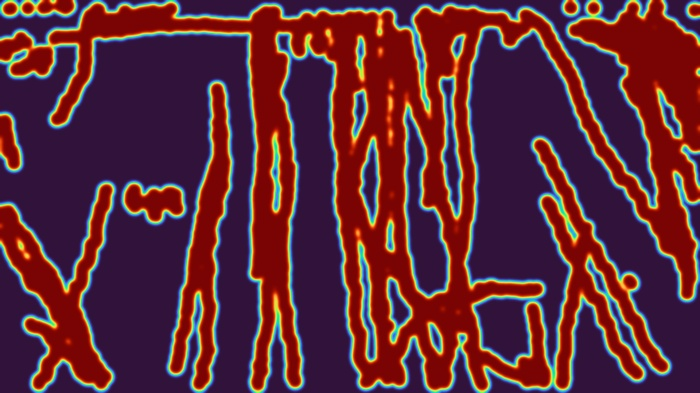

In [ ]:
# Display heatmap image
display(HTML("<h4>🖼️ Final Heatmap Image</h4>"))
display(Image(filename="output-heatmap-image.jpg"))